# Reconstrction of 3D *Drosophila* embryo model using `STitch3D`

In [1]:
import sys
sys.path.append(r'/import/home/share/zw/pql/STitch3D/')
import STitch3D

import pandas as pd
import numpy as np
import scanpy as sc
import anndata as ad
from scipy.io import mmread
import os

import warnings
warnings.filterwarnings("ignore")

os.environ["CUDA_VISIBLE_DEVICES"] = "0"

/import/home/share/zw/pql/STitch3D/STitch3D/__init__.py


/home/zwanghc/anaconda3/envs/stitch3d/lib/python3.7/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
DATA_PATH = "/import/home/share/zw/data/Drosophila_embryo/" # Raw data
SAVE_PATH = "/import/home/share/zw/pql/data/Drosophila_embryo/" # Deconvolution results

if not os.path.exists(SAVE_PATH):
    os.makedirs(SAVE_PATH)

In [3]:
# scRNA-seq data

ref_count = mmread(DATA_PATH + "Calderon_2022/GSE190147_scirnaseq_gene_matrix.mtx")
ref_row = pd.read_csv(DATA_PATH + "Calderon_2022/GSE190147_scirnaseq_gene_matrix.rows.txt",
                      header=None, index_col=0)
ref_col = pd.read_csv(DATA_PATH + "Calderon_2022/GSE190147_scirnaseq_gene_matrix.columns.txt",
                      index_col=0, sep='\t')

adata_ref_raw = ad.AnnData(X=ref_count.tocsr().T)
adata_ref_raw.obs = ref_col
adata_ref_raw.var.index = [str(i) for i in list(ref_row.index)]

In [4]:
adata_ref = ad.AnnData(X=adata_ref_raw.X)
adata_ref.obs = adata_ref_raw.obs
adata_ref.var = adata_ref_raw.var

adata_ref = adata_ref[adata_ref.obs['time'] == 'hrs_16_20']
adata_ref.obs.rename(columns = {'exp': 'exp_idx'}, inplace = True)

clust = pd.read_csv(DATA_PATH + "Calderon_2022/seurat_clust_1620.txt", sep=" ")
clust.index = clust.barcode.values.astype(str)
clust = clust.loc[adata_ref.obs.index, :]
adata_ref.obs["seurat_clust"] = clust.clust.values.astype(str)

#transfer clusters to cell type annotations
anno_table = pd.read_csv(DATA_PATH + "Calderon_2022/cluster_anno_table.csv")

adata_ref.obs['celltype'] = adata_ref.obs['seurat_clust'].values.astype(str)
for i in range(anno_table.shape[0]):
    adata_ref.obs['celltype'] = adata_ref.obs['celltype'].replace(anno_table["cluster"][i].astype(str),
                                                                  anno_table["annotation"][i])

adata_ref = adata_ref[(adata_ref.obs['celltype'] != "lowq") & (adata_ref.obs['celltype'] != "unk"), :]
clust = clust.loc[adata_ref.obs.index, :]

Trying to set attribute `.obs` of view, copying.


In [5]:
# plot umap
adata_ref_umap = adata_ref.copy()
hvg_num = 2000
sc.pp.highly_variable_genes(adata_ref_umap, flavor='seurat_v3', n_top_genes=hvg_num)
sc.pp.normalize_total(adata_ref_umap, target_sum=1e4)
sc.pp.log1p(adata_ref_umap)
sc.pp.scale(adata_ref_umap, max_value=10)
sc.tl.pca(adata_ref_umap, n_comps=30, svd_solver='arpack')
sc.pp.neighbors(adata_ref_umap, n_pcs=30)
sc.tl.umap(adata_ref_umap)
sc.pl.umap(adata_ref_umap, color=['celltype'])

In [6]:
# ST data

adata_st_raw = sc.read_h5ad(DATA_PATH + "stereoseq_data/E16-18h_a_count_normal_stereoseq.h5ad")
adata_st_raw.X = adata_st_raw.layers['raw_counts']

slice_all = sorted(list(set(adata_st_raw.obs['slice_ID'].values)))[:-1]

adata_st_list_raw = []
for slice_id in slice_all:
    adata_st_i = adata_st_raw[adata_st_raw.obs['slice_ID'].values == slice_id]
    adata_st_i.obsm['spatial'] = np.concatenate((adata_st_i.obs['raw_x'].values.reshape(-1, 1),
                                                 adata_st_i.obs['raw_y'].values.reshape(-1, 1)), axis=1) / 20
    adata_st_i.obsm['loc_use'] = np.concatenate((adata_st_i.obs['raw_x'].values.reshape(-1, 1),
                                                 adata_st_i.obs['raw_y'].values.reshape(-1, 1)), axis=1) / 20
    adata_st_i.obsm['coor_3d'] = np.concatenate((adata_st_i.obs['new_x'].values.reshape(-1, 1),
                                                 adata_st_i.obs['new_y'].values.reshape(-1, 1),
                                                 adata_st_i.obs['new_z'].values.reshape(-1, 1)), axis=1)
    adata_st_i.obs['array_row'] = adata_st_i.obs['raw_y'].values
    adata_st_i.obs['array_col'] = adata_st_i.obs['raw_x'].values

    adata_st_list_raw.append(adata_st_i.copy())

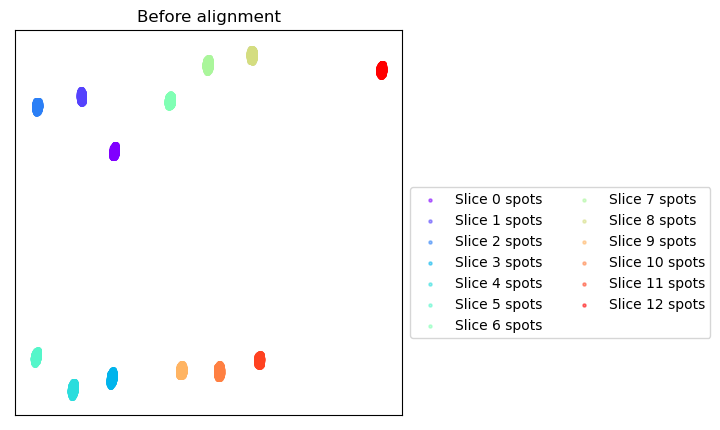

Using PASTE algorithm for alignemnt.
Aligning spots...


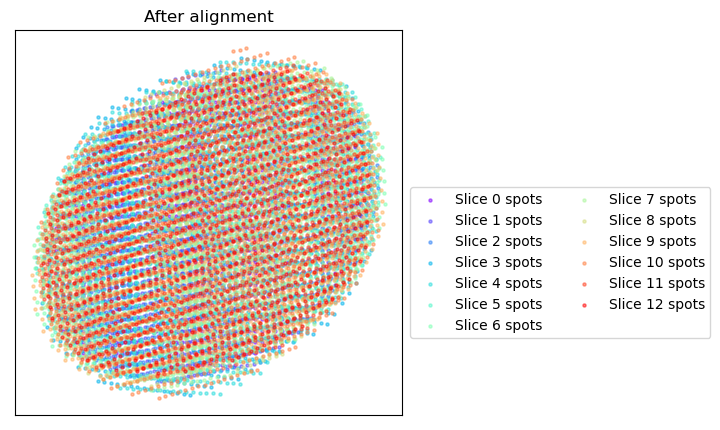

In [7]:
# Align multiple ST slices
adata_st_list = STitch3D.utils.align_spots(adata_st_list_raw, data_type = "ST", coor_key = "loc_use",
                                           method = 'paste', plot = True)

In [8]:
adata_st, adata_basis = STitch3D.utils.preprocess(adata_st_list,
                                                  adata_ref,
                                                  celltype_ref_col = "celltype",
                                                  sample_col = "exp_idx",
                                                  n_hvg_group=500,
                                                  slice_dist_micron = [1.]*(len(adata_st_list)-1),
                                                  c2c_dist = 1.,
                                                  save_path = SAVE_PATH)

Finding highly variable genes...


Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
... storing 'exp_idx' as categorical
... storing 'time' as categorical
... storing 'seurat_clust' as categorical
... storing 'celltype' as categorical
Trying to set attribute `.obs` of view, copying.


5838 highly variable genes selected.
Calculate basis for deconvolution...
3 batches are used for computing the basis vector of cell type <CNS>.
3 batches are used for computing the basis vector of cell type <amnioserosa>.
3 batches are used for computing the basis vector of cell type <epidermis>.
3 batches are used for computing the basis vector of cell type <fat body>.
3 batches are used for computing the basis vector of cell type <foregut>.
3 batches are used for computing the basis vector of cell type <hindgut>.
3 batches are used for computing the basis vector of cell type <midgut>.
3 batches are used for computing the basis vector of cell type <muscle>.
3 batches are used for computing the basis vector of cell type <oenocyte>.
3 batches are used for computing the basis vector of cell type <plasmatocytes>.
3 batches are used for computing the basis vector of cell type <proventriculus>.
3 batches are used for computing the basis vector of cell type <salivary gland>.
3 batches are us

In [12]:
# Run STitch3D
model = STitch3D.model.Model(adata_st, adata_basis)
model.train()

  0%|          | 1/20000 [00:00<1:25:31,  3.90it/s]

Step: 0, Loss: 2598.0420, d_loss: 2592.9995, f_loss: 50.4259


 10%|█         | 2001/20000 [07:45<1:11:38,  4.19it/s]

Step: 2000, Loss: 34.4026, d_loss: 31.2073, f_loss: 31.9530


 20%|██        | 4001/20000 [15:31<1:03:38,  4.19it/s]

Step: 4000, Loss: -36.5674, d_loss: -39.7165, f_loss: 31.4905


 30%|███       | 6001/20000 [23:18<55:44,  4.19it/s]  

Step: 6000, Loss: -48.4285, d_loss: -51.5507, f_loss: 31.2217


 40%|████      | 8001/20000 [31:05<47:46,  4.19it/s]

Step: 8000, Loss: -49.6632, d_loss: -52.7686, f_loss: 31.0534


 50%|█████     | 10001/20000 [38:52<39:46,  4.19it/s]

Step: 10000, Loss: -49.7934, d_loss: -52.8888, f_loss: 30.9542


 60%|██████    | 12001/20000 [46:40<31:53,  4.18it/s]  

Step: 12000, Loss: -50.2523, d_loss: -53.3386, f_loss: 30.8631


 70%|███████   | 14001/20000 [54:27<23:52,  4.19it/s]

Step: 14000, Loss: -50.0374, d_loss: -53.1179, f_loss: 30.8042


 80%|████████  | 16001/20000 [1:02:14<15:56,  4.18it/s]

Step: 16000, Loss: -50.4410, d_loss: -53.5139, f_loss: 30.7280


 90%|█████████ | 18001/20000 [1:10:02<07:57,  4.19it/s]

Step: 18000, Loss: -50.5499, d_loss: -53.6153, f_loss: 30.6546


100%|██████████| 20000/20000 [1:17:48<00:00,  4.28it/s]


In [13]:
result = model.eval(adata_st_list_raw, save=True, output_path=SAVE_PATH)

Slice 1


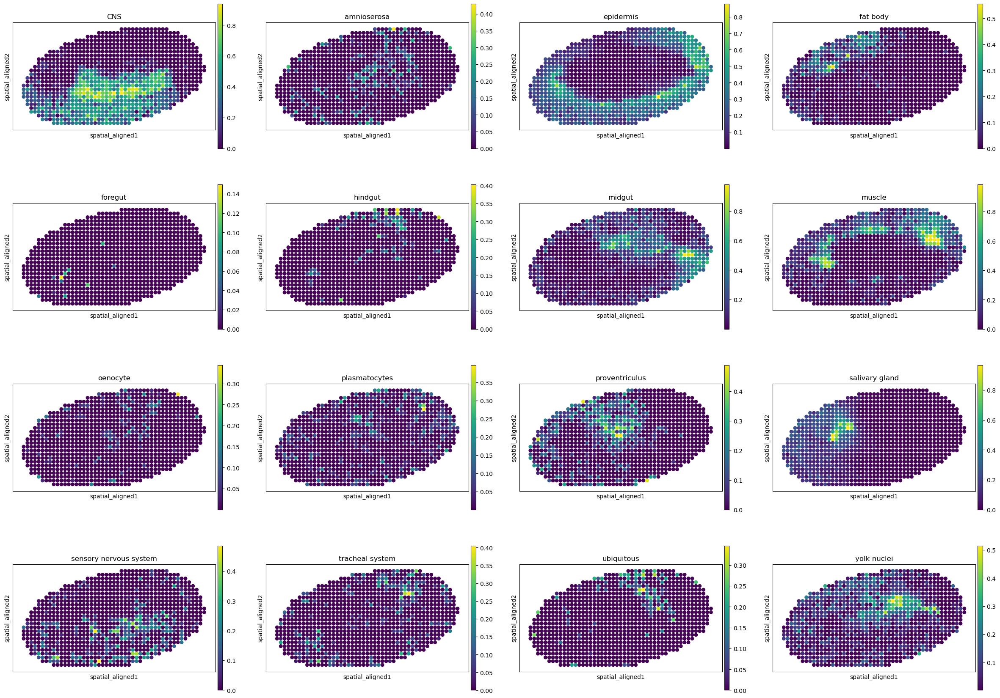

Slice 2


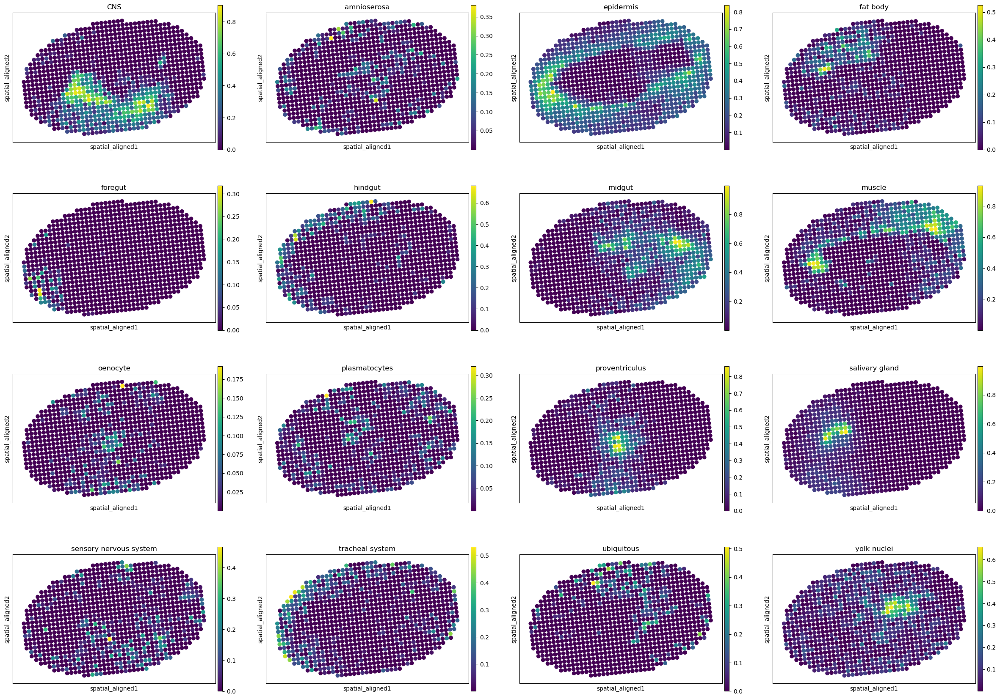

Slice 3


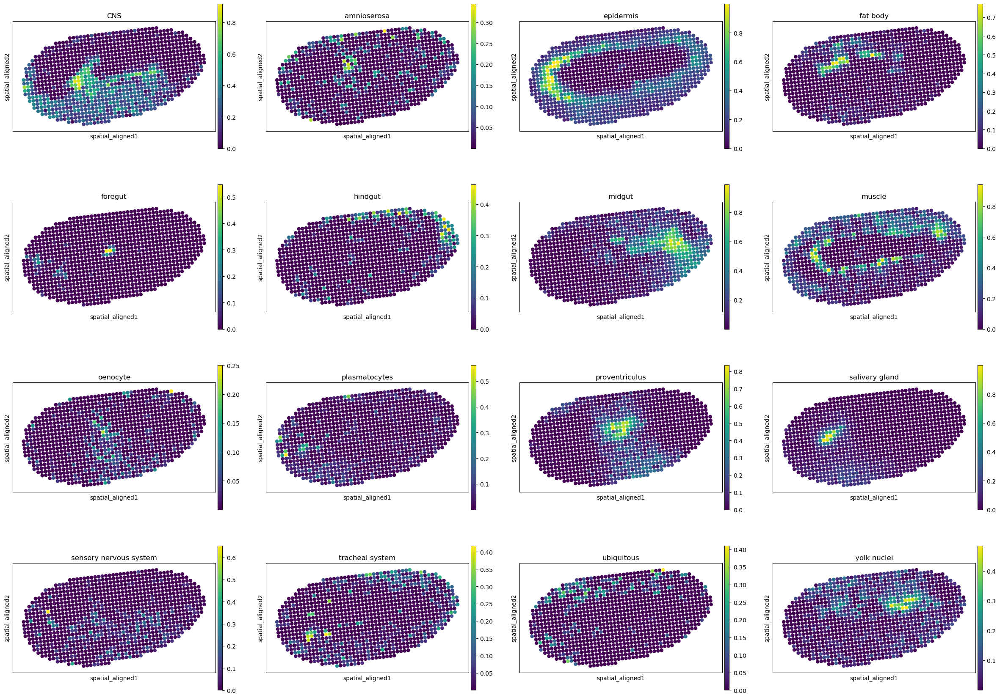

Slice 4


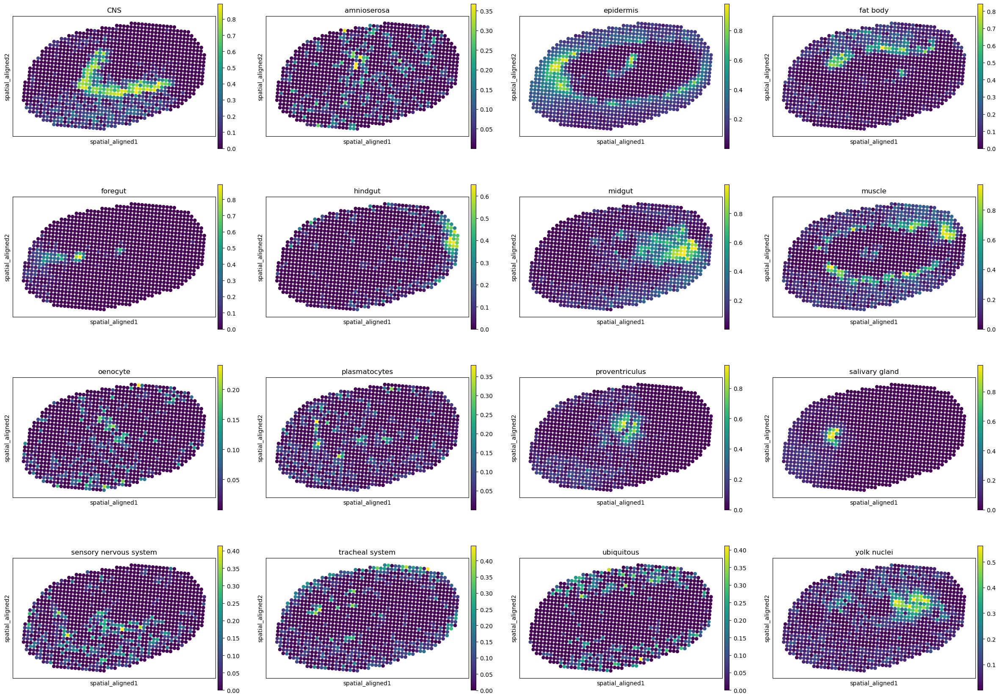

Slice 5


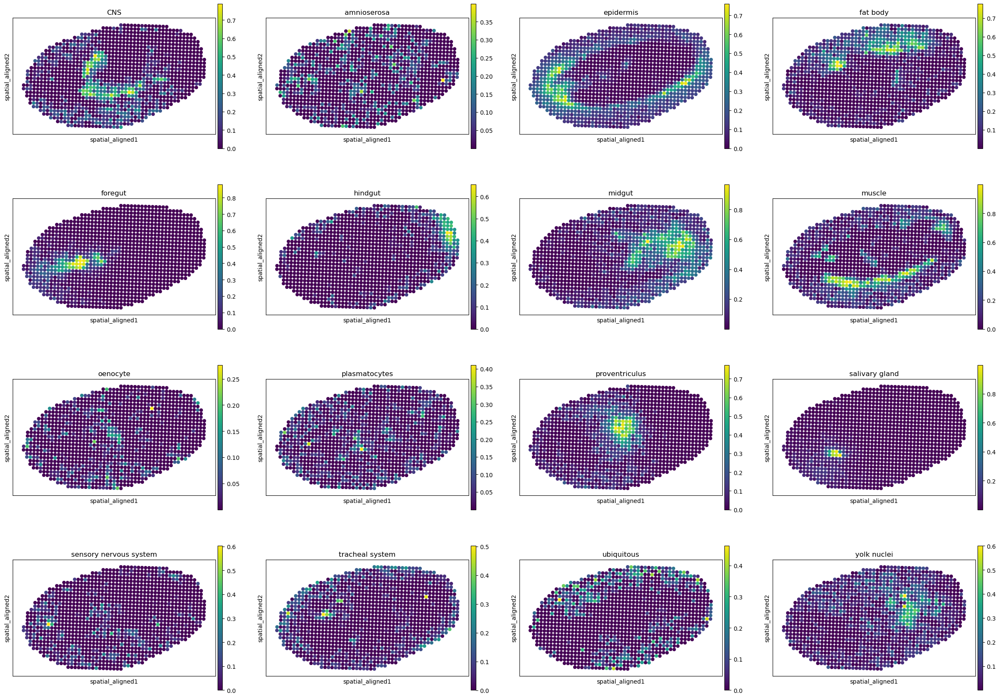

Slice 6


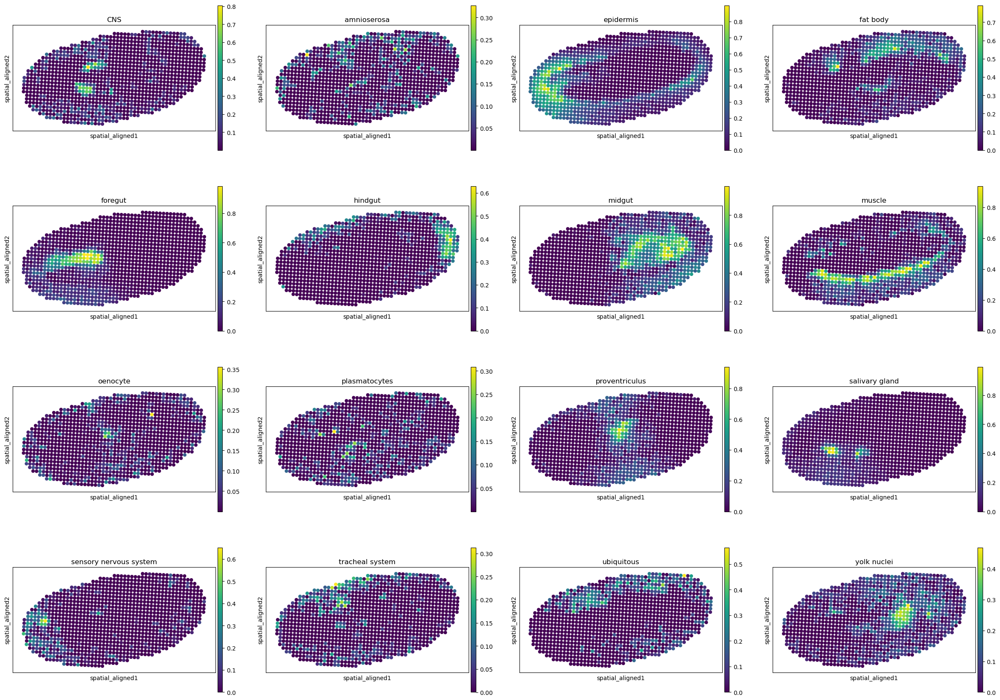

Slice 7


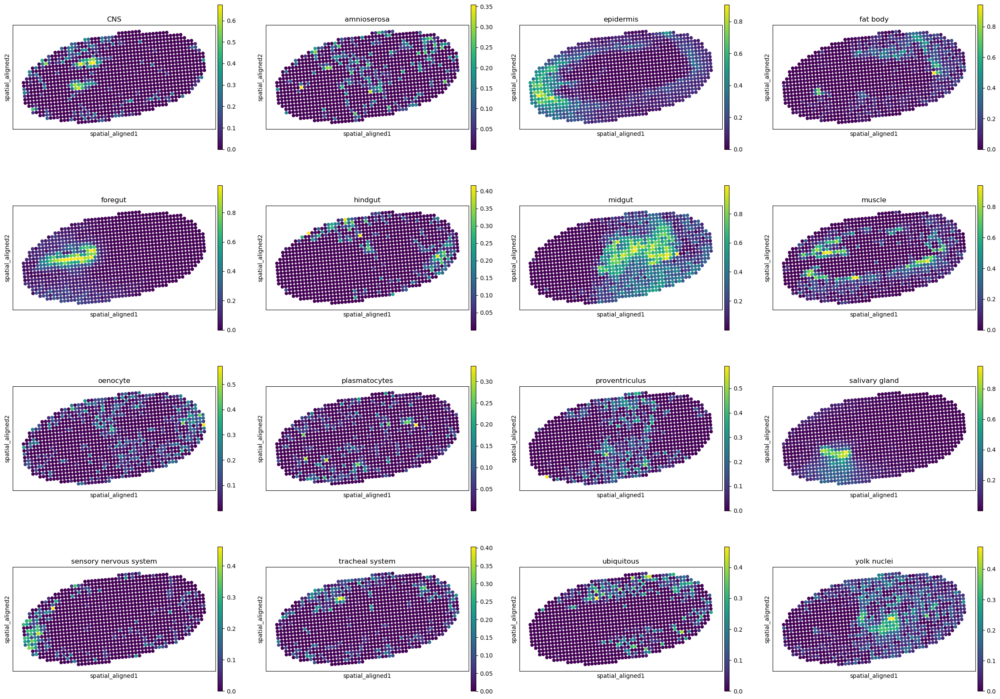

Slice 8


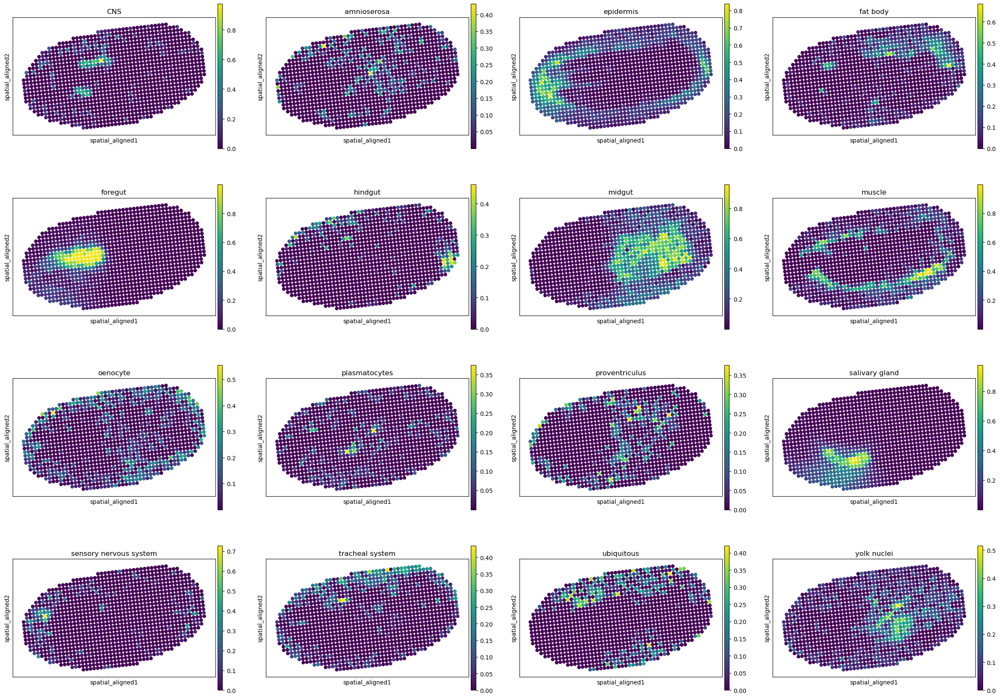

Slice 9


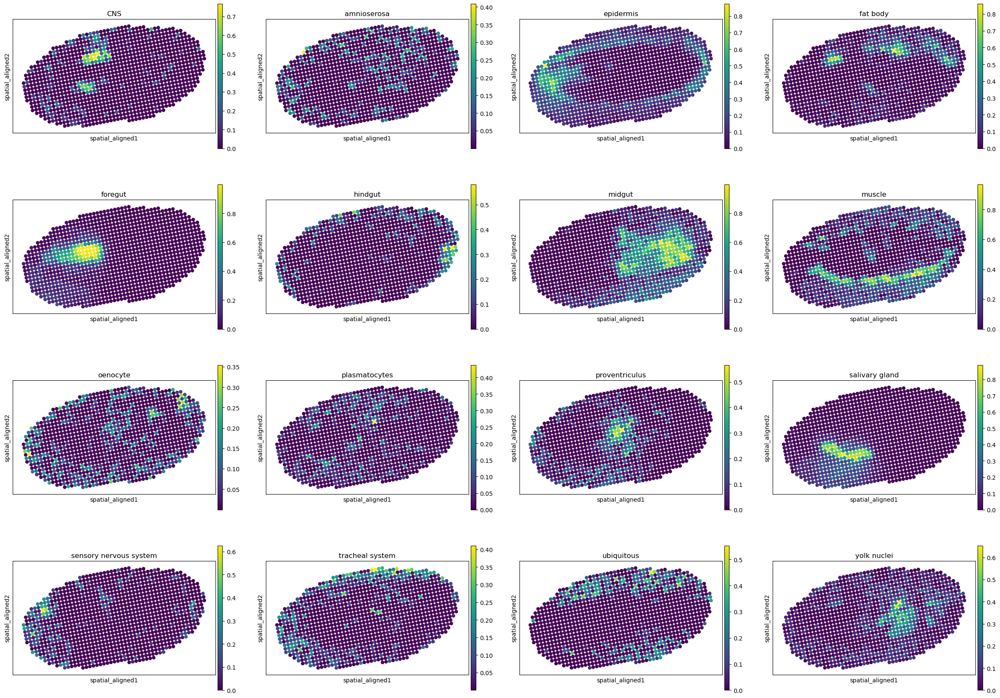

Slice 10


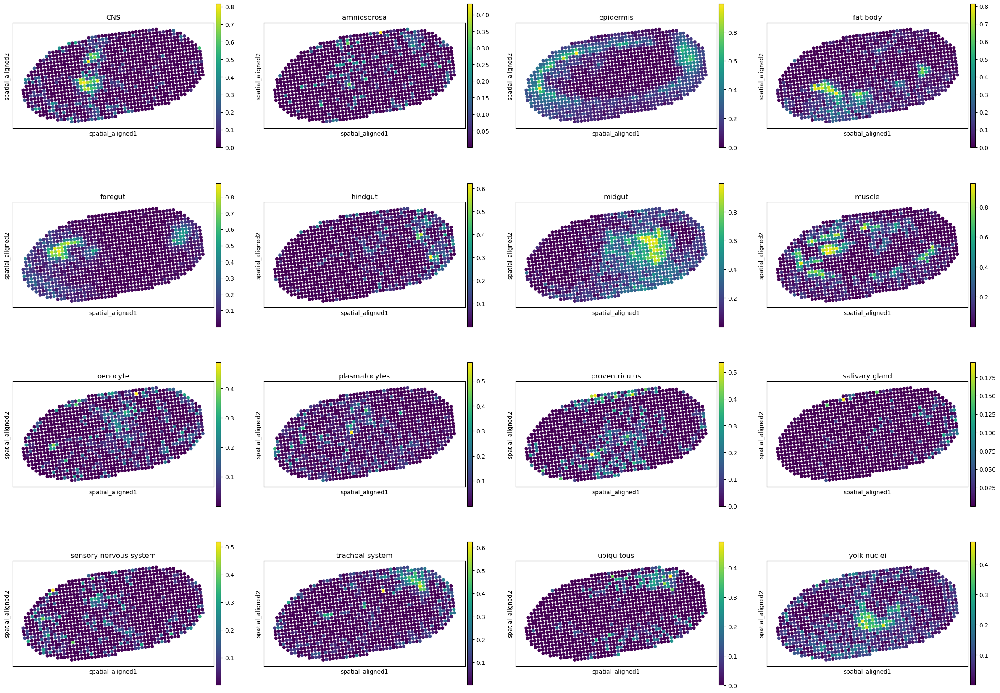

Slice 11


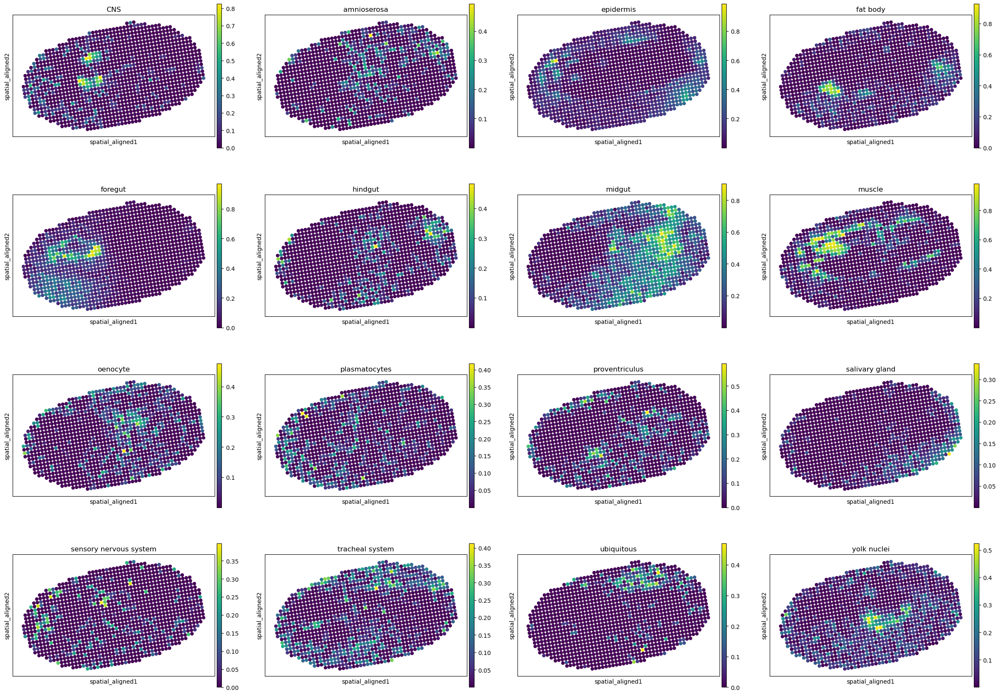

Slice 12


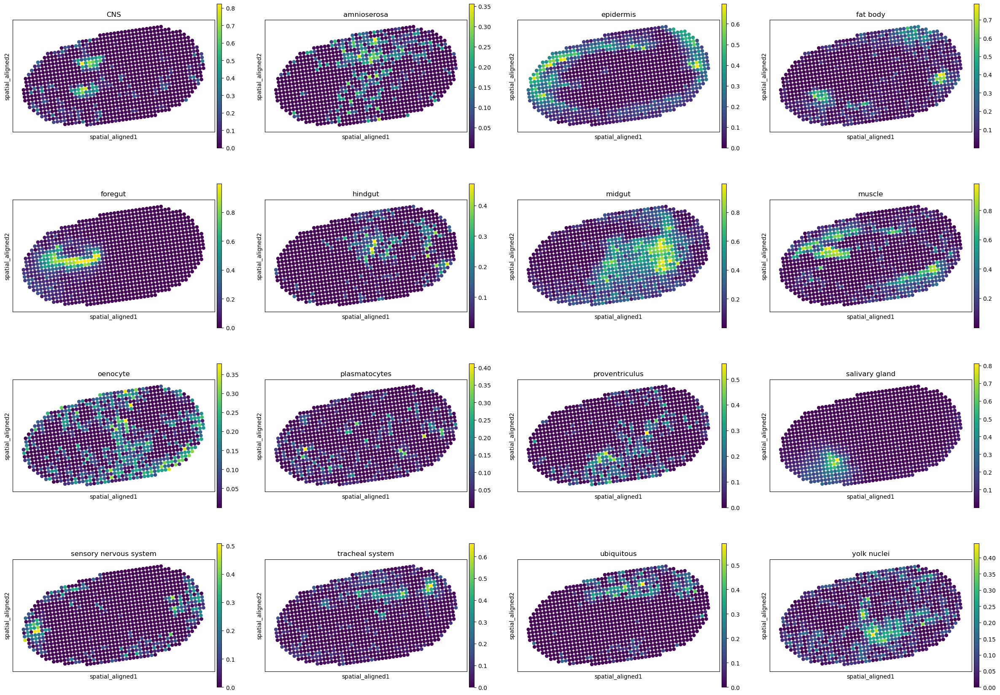

Slice 13


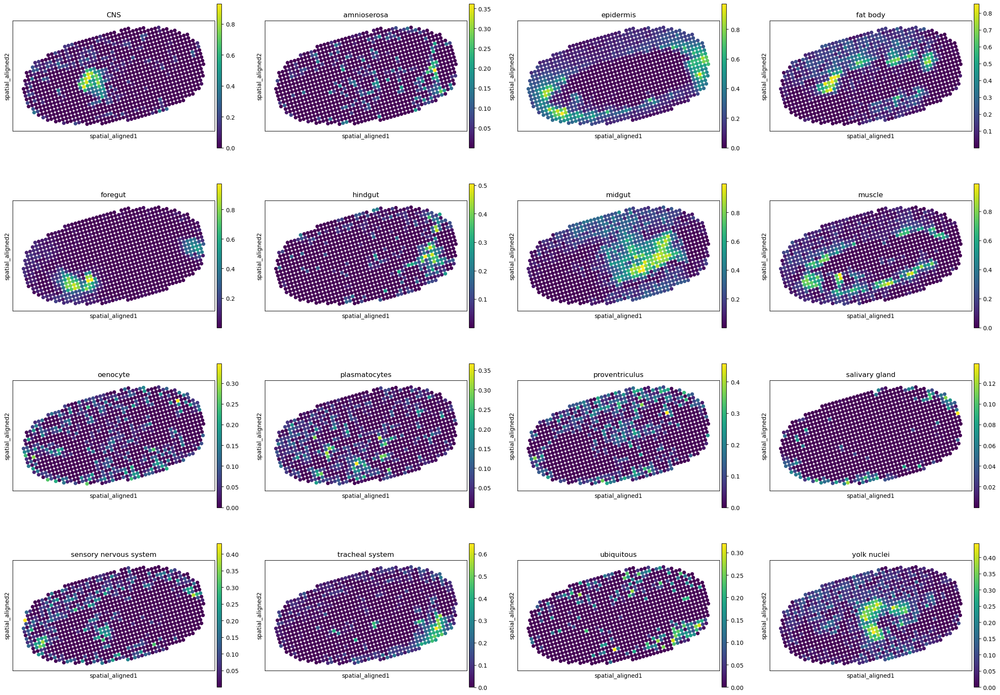

In [14]:
for i, adata_st_i in enumerate(result):
    print("Slice %d" % (i+1))
    sc.pl.spatial(adata_st_i, img_key="hires", basis="spatial_aligned", color=model.celltypes, spot_size=1.)